# Imports

In [30]:
from abc import ABC, abstractmethod
import operator
from typing import Optional, Tuple, TypeVar
import warnings

import numpy as np
import pandas as pd
import pmdarima as pm
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
from scipy import signal
from statsmodels.graphics.tsaplots import acf, pacf, plot_acf, plot_pacf
from statsmodels.tools.sm_exceptions import ConvergenceWarning
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import ExponentialSmoothing, SimpleExpSmoothing
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from tqdm.notebook import tqdm


pyo.init_notebook_mode()
warnings.simplefilter('ignore', ConvergenceWarning)
%matplotlib widget


# Utility functions

## Loading data

In [38]:
def read_sheet(sheet_name):
    df = (
        pd.read_excel(xlsx, sheet_name)
        .iloc[:-1]
        .astype({"Price": float, "Open": float, "High": float, "Low": float})
        .set_index("Date")
        .sort_index(ascending=True)
    )
    df.index = df.index.to_period('D')
    return df

## Plotting

In [39]:
def plot_candlesticks(ohlcv: pd.DataFrame):
    fig = go.Figure(data=[go.Candlestick(
        x=ohlcv.index.to_timestamp(),
        open=ohlcv['Open'],
        high=ohlcv['High'],
        low=ohlcv['Low'],
        close=ohlcv["Price"]
    )])

    fig.update_layout(height=500, xaxis_rangeslider_visible=False)
    return fig


def plot_forecast(signal_train, signal_test, forecast):
    return go.Figure(
        data=[
            go.Scatter(x=signal_train.index.to_timestamp(), y=signal_train, name="Train data", line_color="green"),
            go.Scatter(x=signal_test.index.to_timestamp(), y=signal_test, name="Test data", line_color="red"),
            go.Scatter(x=signal_test.index.to_timestamp(), y=forecast, name="Forecast", line_color="blue"),
        ],
        layout=dict(height=500)
    )

## Modeling

In [40]:
T = TypeVar('T', bound='TimeSeriesModel')


class TimeSeriesModel(ABC):
    def __init__(self):
        self.history = None
        
    @abstractmethod
    def fit(self: T, history: pd.Series, exog: Optional[pd.Series] = None) -> T:
        """
        Fits the model onto the history time series as training data.
        :return: the same TimeSeriesModel instance
        :rtype: :class:`TimeSeriesModel`
        """
        self.history = history
        return self

    @abstractmethod
    def update(self: T, value) -> T:
        """
        Fits the model adding the new value to the history
        :return: the same TimeSeriesModel instance
        :rtype: :class:`TimeSeriesModel`
        """

    @abstractmethod
    def forecast(self, exog=None) -> float:
        """
        Forecast next value in time series
        """


class StatsmodelsTimeSeriesModelWrapper(TimeSeriesModel):
    def __init__(self, model_class, use_exogenous=True, **hyperparameters):
        self.model_class = model_class
        self.hyperparameters = hyperparameters
        self.use_exogenous = use_exogenous
        self.model = None
        self.history = None
        self.exogenous = None

    def __getattr__(self, attr):
        if self.model is not None:
            return getattr(self.model, attr)
    
    def fit(self, history, exog=None):
        if exog is not None and self.use_exogenous:
            self.model = self.model_class(history, exog=exog, **self.hyperparameters).fit()
        else:
            self.model = self.model_class(history, **self.hyperparameters).fit()
        self.history = history
        self.exogenous = exog
        return self

    def update(self, value, exog=None):
        new_history = np.concatenate((self.history, np.array([value])))
        if exog is not None and self.use_exogenous:
            new_exogenous = np.concatenate((self.exogenous, np.array([exog])))
        else:
            new_exogenous = None
        self.fit(new_history, new_exogenous)

    def forecast(self, exog=None):
        if exog is not None and self.use_exogenous:
            return self.model.forecast(exog=np.array(exog).reshape((-1, 1)))
        else:
            return self.model.forecast()


class AutoArimaWrapper(TimeSeriesModel):
    def __init__(self, use_exogenous=True, **hyperparameters):
        self.hyperparameters = hyperparameters
        self.use_exogenous = use_exogenous
        self.model = None

    def __getattr__(self, attr):
        if self.model is not None:
            return getattr(self.model, attr)
    
    def fit(self, history, exog=None):
        if exog is not None and self.use_exogenous:
            self.model = pm.auto_arima(
                history,
                exog.values.reshape((-1, 1)),
                **self.hyperparameters
            )
        else:
            self.model = pm.auto_arima(
                history,
                **self.hyperparameters
            )
        return self

    def update(self, value, exog=None):
        if exog is not None and self.use_exogenous:
            return self.model.update(value, X=np.array(exog).reshape(1, -1))

    def forecast(self, exog=None):
        if exog is not None and self.use_exogenous:
            return self.model.predict(n_periods=1, X=np.array(exog).reshape((-1, 1)))
        else:
            return self.model.predict(n_periods=1)

        
def check_stationarity(ts):
    dftest = adfuller(ts)
    adf = dftest[0]
    pvalue = dftest[1]
    critical_value = dftest[4]['5%']
    print(f"pvalue: {pvalue}")
    if (pvalue < 0.05) and (adf < critical_value):
        print('The series is stationary')
    else:
        print('The series is NOT stationary')

## Forecasting

In [41]:
def time_series_rolling_forecast(model: TimeSeriesModel, train, test, exog_train=None, exog_test=None):    
    predictions = []

    exog_test_iterable = exog_test if exog_test is not None else [None] * len(test)

    if exog_train is not None:
        model.fit(train, exog=exog_train)
    else:
        model.fit(train)
    
    for value, exog in tqdm(zip(test, exog_test_iterable), total=len(test), desc="Rolling forecast", leave=False):
        forecast = model.forecast(exog=exog)
        model.update(value, exog=exog)
        predictions.append(forecast[0])
            
    return pd.Series(predictions)


## Evaluation

In [42]:
def mean_absolute_percentage_error(y_true, y_pred): 
    return ((y_pred - y_true).abs().sum() / y_true.sum()) * 100


def get_sign_accuracy(y_true, y_pred):
    true_sign = pd.Series(y_true).diff().iloc[1:] > 0
    pred_sign = pd.Series(y_pred).diff().iloc[1:] > 0

    return (true_sign == pred_sign).mean()


def show_results(train_series, test_series, forecasted_series):
    mape = mean_absolute_percentage_error(test_series.values, forecasted_series)
    fig = plot_forecast(train_series, test_series, forecasted_series)
    fig.update_layout(title=f"MAPE: {mape:.2f}")
    return fig

# Load data

In [43]:
data_file = "2020Q1Q2Q3Q4-2021Q1.xlsx"
xlsx = pd.ExcelFile(data_file)
sheet_names = xlsx.sheet_names

dfs = {
    sheet: read_sheet(sheet)
    for sheet in xlsx.sheet_names
}

In [44]:
sheet_names

['Russia - Sberbank Rossii PAO (S',
 'Turkey - Koc Holding AS (KCHOL)',
 'Egypt - Medinet Nasr Housing (M',
 'Brazil - Minerva SABrazil (BEEF',
 'Argentina - Pampa Energia SA (P',
 'Colombia - Cementos Argos SA (C',
 'South Africa - Impala Platinum ',
 'South Korea - Dongkuk Steel Mil']

# Stock A

## Exploring

In [15]:
df = dfs[sheet_names[0]]

In [16]:
plot_candlesticks(df)

### Check for stationarity to find the differentiation order

### Find D order

In [17]:
check_stationarity(df.Price)

pvalue: 0.758206636387682
The series is NOT stationary


In [18]:
check_stationarity(df.Price.diff().dropna())

pvalue: 4.6146668027330687e-07
The series is stationary


It seems the order is D=1

In [19]:
price_diff = df.Price.diff().fillna(0)

In [20]:
fig = px.line(price_diff.values)
fig.update_layout(height=500)

### Find AR and MA orders

For the differenced stock price, we can plot the autocorrelation and the partial autocorrelation to find the p (autoregressive) and q (moving average) parameters.

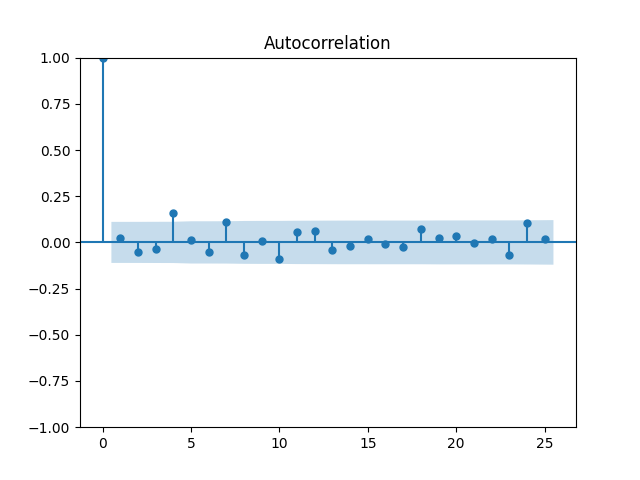

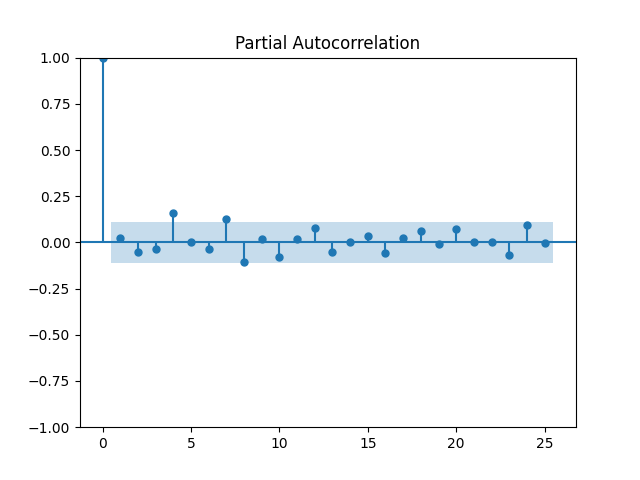

In [21]:
plot_acf(price_diff);
plot_pacf(price_diff);

From a visual inspection, we do not see any significant dependence of the change signal with previous samples.
In any case, we could set P=4 and Q=4 since there seems to be a coefficient in there.

### Check for seasonal component

Let's find first an estimation for the period. The trend is clearly 0, so we can take a look at the spectrum

In [22]:
window = signal.windows.hamming(price_diff.size)
price_diff_windowed = price_diff * window
freq, power_spectral_density = signal.periodogram(price_diff_windowed)
go.Figure(
    go.Scatter(x=freq, y=power_spectral_density),
    layout=dict(height=500)
)

We find two really pronounced peaks at frequencies 0.1 and 0.33, indicating possible periodicities for seasonality of 10 days and 3 days respectively. However there is a lot of noise, so I am not clear that adding this seasonality would be of any help.

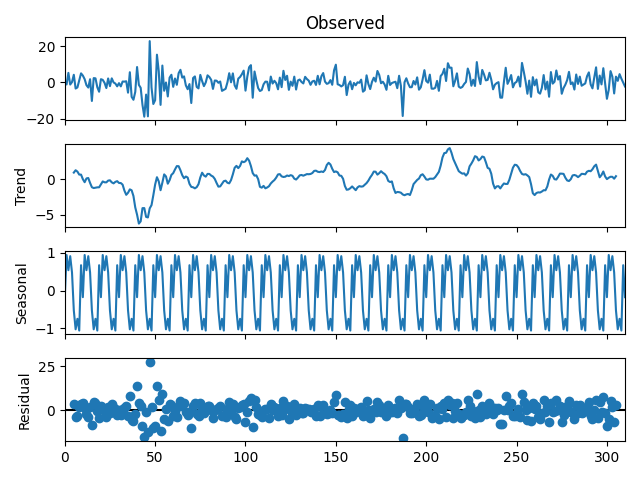

In [23]:
result = seasonal_decompose(price_diff.values, model="additive", period=10)
result.plot();

The seasonal component for a period of 10 samples has an amplitude of 1, which is not too much taking in account that the amplitude of the signal is around 20.
Let's examine its autocorrelation and partial autocorrelation:

pvalue: 0.0
The series is stationary


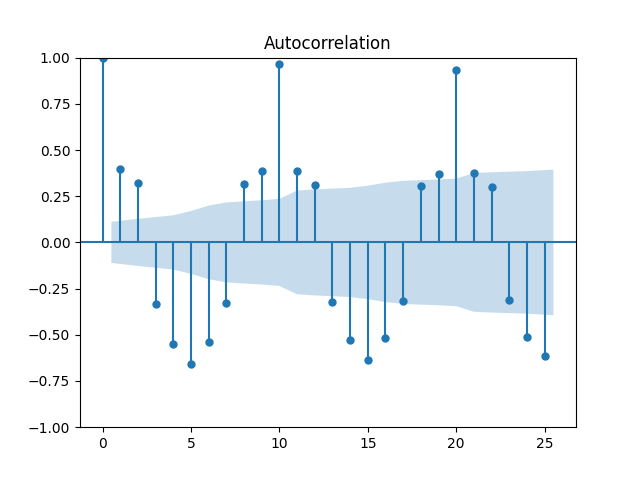

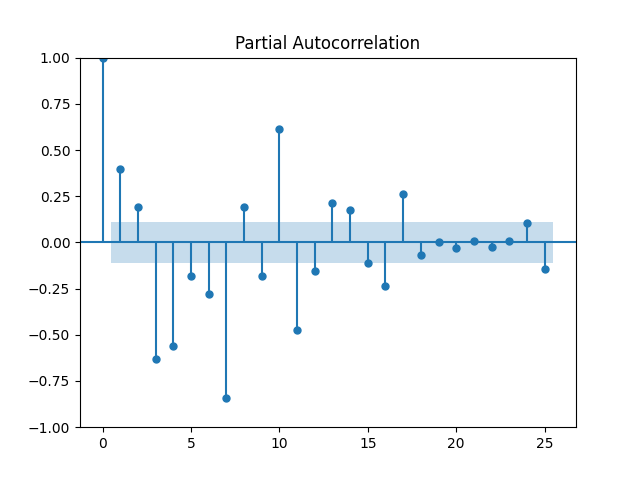

In [24]:
seasonal = result.seasonal
check_stationarity(seasonal)
plot_acf(seasonal);
plot_pacf(seasonal);

## Modeling

In [25]:
is_train = df.index.year < 2021
df_train = df[is_train]
df_test = df[~is_train]

### ARIMA

In [26]:
AR_order = 4
differentiation_order = 1
MA_order = 0

arima_wrapper = StatsmodelsTimeSeriesModelWrapper(ARIMA, order=(AR_order, differentiation_order, MA_order))

forecast_arima = time_series_rolling_forecast(
    arima_wrapper,
    df_train.Price,
    df_test.Price
)

Rolling forecast:   0%|          | 0/61 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
show_results(df_train.Price, df_test.Price, forecast_arima)

In [ ]:
AR_order = 4
differentiation_order = 1
MA_order = 4

arima_wrapper = StatsmodelsTimeSeriesModelWrapper(ARIMA, order=(AR_order, differentiation_order, MA_order))

forecast_arima = time_series_rolling_forecast(
    arima_wrapper,
    df_train.Price,
    df_test.Price
)

In [ ]:
show_results(df_train.Price, df_test.Price, forecast_arima)

### SARIMA

In [ ]:
sarimax_wrapper = StatsmodelsTimeSeriesModelWrapper(
    SARIMAX,
    order=(AR_order, differentiation_order, MA_order),
    seasonal_order=(4,0,0,10),
    enforce_stationarity=False
)
        
forecast_sarima = time_series_rolling_forecast(
    sarimax_wrapper,
    df_train.Price,
    df_test.Price
)

In [ ]:
show_results(df_train.Price, df_test.Price, forecast_sarima)

### SARIMAX

In [ ]:
volume = df["Vol."].map(lambda volume: float(volume.rstrip("M")))
volume_previous_day = volume.shift().bfill()
volume_train_previous_day = volume_previous_day[is_train]
volume_test_previous_day = volume_previous_day[~is_train]

In [ ]:
AR_order = 1
differentiation_order = 0
MA_order = 0

sarimax_wrapper = StatsmodelsTimeSeriesModelWrapper(
    SARIMAX,
    order=(AR_order, differentiation_order, MA_order),
    enforce_stationarity=False
)

forecast_sarimax = time_series_rolling_forecast(
    sarimax_wrapper,
    df_train.Price,
    df_test.Price,
    exog_train=volume_train_previous_day,
    exog_test=volume_test_previous_day
)

show_results(df_train.Price, df_test.Price, forecast_sarimax)

### Automatic setting of model parameters (AutoArima)

In [ ]:
model_autoarima = AutoArimaWrapper(
    start_p=1, 
    start_q=1,
    m=10,
    suppress_warnings=False
)

forecast_autoarima = time_series_rolling_forecast(model_autoarima, df_train.Price, df_test.Price, volume_train_previous_day, volume_test_previous_day)

show_results(df_train.Price, df_test.Price, forecast_autoarima)

### Exponential Smoothing

In [ ]:
model_ses = StatsmodelsTimeSeriesModelWrapper(SimpleExpSmoothing)
forecast_ses = time_series_rolling_forecast(model_ses, df_train.Price, df_test.Price)
show_results(df_train.Price, df_test.Price, forecast_ses)

The optimized smoothing parameter value is practically 1, which means the algorithm found all meaningful information for predicting today's price is yesterday's price.

Let's try now with the change in price:

In [ ]:
price_diff = df.Price.diff().fillna(0)
price_diff_train = price_diff[is_train]
price_diff_test = price_diff[~is_train]

In [ ]:
forecast_ses_change = time_series_rolling_forecast(model_ses, price_diff_train, price_diff_test)
show_results(price_diff_train, price_diff_test, forecast_ses_change)

The algorithm can conclude nothing with the difference of price:

In [ ]:
model_ses.params

We can try to add trend prediction to see if it helps

In [ ]:
model_exps = StatsmodelsTimeSeriesModelWrapper(ExponentialSmoothing, trend="add")
forecast_exps = time_series_rolling_forecast(model_exps, df_train.Price, df_test.Price)
show_results(df_train.Price, df_test.Price, forecast_exps)


# All signals

Now we apply the AutoARIMA and SimpleExpSmoothing to all signals and calculate their MAPE:

In [45]:
def process_signal(stock_data: pd.DataFrame, model: TimeSeriesModel):
    def parse_volume(volume_string):
        unit = volume_string[-1]
        try:
            quantity = float(volume_string[:-1])
        except ValueError:
            return 0
            
        if unit == "M":
            return quantity
        elif unit == "K":
            return quantity / 1000
    
    def train_test_split(x):
        is_train = x.index.year < 2021
        return x[is_train], x[~is_train]
    
    price = stock_data["Price"]
    volume = stock_data["Vol."].map(parse_volume)
    volume_previous_day = volume.shift().bfill()
    
    price_train, price_test = train_test_split(price)
    volume_train_previous_day, volume_test_previous_day = train_test_split(volume_previous_day)
    
    forecast = time_series_rolling_forecast(model, price_train, price_test, volume_train_previous_day, volume_test_previous_day)
    mape = mean_absolute_percentage_error(price_test.values, forecast)
    sign_accuracy = get_sign_accuracy(price_test.values, forecast)
    
    fig = show_results(price_train, price_test, forecast);

    return model.summary(), forecast, mape, sign_accuracy, fig

In [ ]:
from collections import defaultdict
import warnings

warnings.filterwarnings('ignore')


model_autoarima = AutoArimaWrapper(
    start_p=1, 
    start_q=1,
    suppress_warnings=False
)

model_ses = StatsmodelsTimeSeriesModelWrapper(SimpleExpSmoothing, use_exogenous=False)

models = dict(autoarima=model_autoarima, ses=model_ses)

results = defaultdict(dict)
pbar = tqdm(dfs.items())
for sheet, df in pbar:
    pbar.set_description(f"Sheet: {sheet}")
    for name, model in tqdm(models.items(), desc="Models", leave=False):
        results[sheet][name] = process_signal(df, model)

  0%|          | 0/8 [00:00<?, ?it/s]

Models:   0%|          | 0/2 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/61 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/61 [00:00<?, ?it/s]

Models:   0%|          | 0/2 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/63 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/63 [00:00<?, ?it/s]

Models:   0%|          | 0/2 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/62 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/62 [00:00<?, ?it/s]

Models:   0%|          | 0/2 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/60 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/60 [00:00<?, ?it/s]

Models:   0%|          | 0/2 [00:00<?, ?it/s]

Rolling forecast:   0%|          | 0/60 [00:00<?, ?it/s]

In [ ]:
mapes = pd.DataFrame(results).T.applymap(lambda x: x[2])

mapes_baseline = {
    stock: mean_absolute_percentage_error(data.Price, data.Price.shift(-1))
    for stock, data in dfs.items()
}

mapes["Baseline"] = pd.Series(mapes_baseline)

mapes_plot = mapes.rename_axis(columns="Model", index="Stock").stack().rename("Mape").reset_index()
mapes_plot.Model = mapes_plot.Model.map(str)

px.bar(
    mapes_plot,
    x="Stock",
    y="Mape",
    color="Model",
    barmode="group",
    height=500,
)

We can take a look at the accuracy at predicting whether the price is going to go up or down.

In [ ]:
sign_accuracies = pd.DataFrame(results).T.applymap(lambda x: x[3])
sign_accuracies

In [ ]:
sign_accuracies.mean()

# LSTM Network

https://machinelearningmastery.com/lstm-for-time-series-prediction-in-pytorch/

In [10]:
import torch


def create_dataset(dataset, lookback):
    """Transform a time series into a prediction dataset
    
    Args:
        dataset: A numpy array of time series, first dimension is the time steps
        lookback: Size of window for prediction
    """
    X, y = [], []
    for i in range(len(dataset)-lookback):
        feature = dataset[i:i+lookback]
        target = dataset[i+1:i+lookback+1]
        X.append(feature)
        y.append(target)
    return torch.tensor(X), torch.tensor(y)


def train_test_split(x):
    is_train = x.index.year < 2021
    return x[is_train], x[~is_train]

In [11]:
df = list(dfs.values())[0]
df_train, df_test = train_test_split(df)

lookback = 10
X_train, y_train = create_dataset(df_train[["Price"]].values.astype("float"), lookback)
X_test, y_test = create_dataset(df_test[["Price"]].values.astype("float"), lookback)

C:\Users\chana\AppData\Local\Temp\ipykernel_8920\2912112243.py:17: UserWarning:

Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:248.)



In [43]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data


class LSTMModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.lstm = nn.LSTM(input_size=1, hidden_size=50, num_layers=1, batch_first=True)
        self.linear = nn.Linear(50, 1)
        
    def forward(self, x):
        x_min, _ = torch.min(x, dim=1, keepdim=True)
        x_max, _ = torch.max(x, dim=1, keepdim=True)
        x = (x - x_min) / (x_max - x_min)
        x, _ = self.lstm(x)
        x = self.linear(x)
        x = x * (x_max - x_min) + x_min
        return x


model = LSTMModel()
model = model.float()
optimizer = optim.Adam(model.parameters(), lr=0.01)
loss_fn = nn.MSELoss()
loader = data.DataLoader(data.TensorDataset(X_train, y_train), shuffle=True, batch_size=8)
 
n_epochs = 1000
pbar = tqdm(range(n_epochs), desc="Training", unit="epochs")
for epoch in pbar:
    model.train()
    for X_batch, y_batch in loader:
        y_pred = model(X_batch.float())
        loss = loss_fn(y_pred.float(), y_batch.float())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    if epoch % 50 != 0:
        continue

    model.eval()
    with torch.no_grad():
        y_pred = model(X_train.float())
        train_rmse = np.sqrt(loss_fn(y_pred, y_train.float()))
        y_pred = model(X_test.float())
        test_rmse = np.sqrt(loss_fn(y_pred, y_test.float()))
    pbar.set_description("Epoch %d: train RMSE %.4f, test RMSE %.4f" % (epoch, train_rmse, test_rmse))
 
with torch.no_grad():
    y_train_pred = pd.Series(model(X_train.float())[:, -1, :].numpy().flatten(), index=df_train.index[lookback:])
    y_test_pred = pd.Series(model(X_test.float())[:, -1, :].numpy().flatten(), index=df_test.index[lookback:])
    

Training:   0%|          | 0/1000 [00:00<?, ?epochs/s]

In [47]:
mean_absolute_percentage_error(df_test.Price.reindex_like(y_test_pred), y_test_pred)

1.4365932307459788

In [44]:
go.Figure(
    data=[
        go.Scatter(x=df.index.to_timestamp(), y=df.Price, name="Real"),
        go.Scatter(x=y_train_pred.index.to_timestamp(), y=y_train_pred),
        go.Scatter(x=y_test_pred.index.to_timestamp(), y=y_test_pred),
    ],
    layout=dict(height=500)
)

Predict sign of movement

In [121]:
import torch


def create_dataset_sign(dataset, lookback):
    """Transform a time series into a prediction dataset
    
    Args:
        dataset: A numpy array of time series, first dimension is the time steps
        lookback: Size of window for prediction
    """
    X, y = [], []
    for i in range(len(dataset)-lookback):
        today_value = dataset[i:i+lookback]
        tomorrow_value = dataset[i+1:i+lookback+1]
        change = tomorrow_value - today_value
        change_sign = change > 0
        X.append(today_value)
        y.append(change_sign.astype("float"))
    return torch.tensor(X), torch.tensor(y)

In [162]:
lookback = 3
X_train, y_train = create_dataset_sign(df_train[["Price"]].values.astype("float"), lookback)
X_test, y_test = create_dataset_sign(df_test[["Price"]].values.astype("float"), lookback)

In [167]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data


class LSTMModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.lstm = nn.LSTM(input_size=1, hidden_size=50, num_layers=1, batch_first=True)
        self.linear = nn.Linear(50, 1)
        
    def forward(self, x):
        x_min, _ = torch.min(x, dim=1, keepdim=True)
        x_max, _ = torch.max(x, dim=1, keepdim=True)
        x = (x - x_min) / (x_max - x_min)
        x, _ = self.lstm(x)
        x = self.linear(x)
        return x


model = LSTMModel()
model = model.float()
optimizer = optim.Adam(model.parameters(), lr=0.01)
loss_fn = torch.nn.BCEWithLogitsLoss()
loader = data.DataLoader(data.TensorDataset(X_train, y_train), shuffle=True, batch_size=8)
 
n_epochs = 500
accuracy_train = []
accuracy_test = []
cross_entropy_train = []
cross_entropy_test = []
pbar = tqdm(range(n_epochs), desc="Training", unit="epochs")
for epoch in pbar:
    model.train()
    for X_batch, y_batch in loader:
        y_pred = model(X_batch.float())
        loss = loss_fn(y_pred.float(), y_batch.float())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    if epoch % 50 != 0:
        continue

    model.eval()
    with torch.no_grad():
        y_pred_train = model(X_train.float())
        train_cross_entropy = loss_fn(y_pred_train.float(), y_train.float())
        y_pred_test = model(X_test.float())
        test_cross_entropy = loss_fn(y_pred_test.float(), y_test.float())
        
        cross_entropy_test.append(test_cross_entropy)
        cross_entropy_train.append(train_cross_entropy)
        accuracy_train.append((y_train == (y_pred_train > 0).float()).float().mean())
        accuracy_test.append((y_test == (y_pred_test > 0).float()).float().mean())
    pbar.set_description("Epoch %d: train CrossEntropy %.4f, test CrossEntropy %.4f" % (epoch, train_cross_entropy, test_cross_entropy))
 
with torch.no_grad():
    y_train_pred = pd.Series(model(X_train.float())[:, -1, :].numpy().flatten(), index=df_train.index[lookback:])
    y_test_pred = pd.Series(model(X_test.float())[:, -1, :].numpy().flatten(), index=df_test.index[lookback:])
    

Training:   0%|          | 0/500 [00:00<?, ?epochs/s]

In [168]:
go.Figure(
    data=[
        go.Scatter(y=accuracy_train),
        go.Scatter(y=accuracy_test),
    ],
    layout=dict(
        height=500
    )
)

# Testing strategies

It fails when I check the position object.
Try to to create a close line

In [189]:
df = dfs[sheet_names[0]]
df["Volume"] = df["Vol."].map(lambda volume: float(volume.rstrip("M")))

In [190]:
import logging

import backtrader as bt
from IPython.core.debugger import set_trace


logging.getLogger().setLevel(logging.INFO)


class CSVData(bt.feeds.PandasData):
    lines = ("close",)
    params = (("close", "Price"),)


order_status_to_string = ["Created", "Submitted", "Accepted", "Partial", "Completed", "Canceled", "Expired", "Margin", "Rejected"]


class TestStrategy(bt.Strategy):
    params = (('pfast', 20),('pslow', 50), ("enable_log", True))

    def __init__(self):
        self.close_price = self.datas[0].close

        self.order = None

        self.slow_sma = bt.indicators.MovingAverageSimple(self.close_price, period=self.params.pslow)
        self.fast_sma = bt.indicators.MovingAverageSimple(self.close_price, period=self.params.pfast)

    def next(self):
        if self.order is not None:
            return

        if not self.position:
            if self.fast_sma[0] >= self.slow_sma[0] and self.fast_sma[-1] < self.slow_sma[-1]:
                self.order = self.buy()
                self._log(f"A buy order was placed. order: {self.order.ref}")
                
            elif self.fast_sma[0] <= self.slow_sma[0] and self.fast_sma[-1] > self.slow_sma[-1]:
                self.order = self.sell()
                self._log(f"A sell order was placed. order: {self.order.ref}")
                
        else:
            if len(self) >= (self.bar_executed + 5):
                self._log("Closing position")
                self.order = self.close()
            else:
                self._log("Waiting to close")

    def notify_order(self, order):
        self._log(f"order status: {order_status_to_string[order.status]}")
        
        if order.status in [order.Submitted, order.Accepted]:
            return

        if order.status == order.Completed:
            self.bar_executed = len(self)
    
        self.order = None

    def _log(self, message):
        if not self.params.enable_log:
            return
            
        current_date = self.datas[0].datetime.date(0)
        logging.info(f"logging {current_date}. {message}")


In [212]:
class BollingerBandStrategy(bt.Strategy):
    params = (
        ('period', 20),  # period for the Bollinger Bands
        ('devfactor', 2.0),  # number of standard deviations for the Bollinger Bands
        ("predictor", None),
        ("enable_log", True),
    )

    def __init__(self):
        self.bband = bt.indicators.BollingerBands(self.data.close, period=self.params.period, devfactor=self.params.devfactor)

    def next(self):
        def predict_price_goes_up():
            close_prices = [self.data.close[i] for i in range(-lookback+1, 1)]
            return self.params.predictor(torch.Tensor(np.expand_dims(np.expand_dims(close_prices, axis=0), axis=2))).detach().numpy().flatten()[-1] > 0
        
        if not self.position:  
            if self.data.close[0] < self.bband.lines.bot[0]:
                price_goes_up = predict_price_goes_up()
                print(f"Bottom. price_goes_up: {price_goes_up}")
                if price_goes_up:
                    self.buy()
            elif self.data.close[0] > self.bband.lines.top[0]:
                price_goes_up = predict_price_goes_up()
                print(f"Top. price_goes_up: {price_goes_up}")
                if not price_goes_up:
                    self.sell()
        else:
            if self.position.size > 0 and self.data.close[0] > self.bband.lines.mid[0]:
                self.close()
            if self.position.size < 0 and self.data.close[0] < self.bband.lines.mid[0]:
                self.close()

    def notify_order(self, order):
        self._log(f"order status: {order_status_to_string[order.status]}")
        
        if order.status in [order.Submitted, order.Accepted]:
            return

        if order.status == order.Completed:
            self.bar_executed = len(self)
    
        self.order = None

    def _log(self, message):
        if not self.params.enable_log:
            return
            
        current_date = self.datas[0].datetime.date(0)
        logging.info(f"logging {current_date}. {message}")


In [193]:
df = list(dfs.values())[0].copy()
df.index = df.index.to_timestamp()
data_feed = CSVData(dataname=df, fromdate=pd.Timestamp(2020, 2, 1), todate=pd.Timestamp(2020, 12, 31))

cerebro = bt.Cerebro()
cerebro.adddata(data_feed)

cerebro.addstrategy(TestStrategy, enable_log=False)
cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name='sharpe_ratio', timeframe=bt.TimeFrame.Days, riskfreerate=0.01, factor=1)
cerebro.addsizer(bt.sizers.SizerFix, stake=3)
start_portfolio_value = cerebro.broker.getvalue()
run = cerebro.run()
end_portfolio_value = cerebro.broker.getvalue()

print(start_portfolio_value, end_portfolio_value)
print(f"Sharpe ratio: {run[0].analyzers.sharpe_ratio.get_analysis()['sharperatio']}")

10000.0 10103.619999999999
Sharpe ratio: -22.84117391329968


In [213]:
df = list(dfs.values())[0].copy()
df.index = df.index.to_timestamp()
data_feed = CSVData(dataname=df, fromdate=pd.Timestamp(2020, 2, 1), todate=pd.Timestamp(2020, 12, 31))

cerebro = bt.Cerebro()
cerebro.adddata(data_feed)

cerebro.addstrategy(BollingerBandStrategy, enable_log=False, predictor=model)

cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name='sharpe_ratio', timeframe=bt.TimeFrame.Days, riskfreerate=0.01, factor=1)
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='PyFolio')

cerebro.addsizer(bt.sizers.SizerFix, stake=3)

start_portfolio_value = cerebro.broker.getvalue()
run = cerebro.run()
end_portfolio_value = cerebro.broker.getvalue()

print(start_portfolio_value, end_portfolio_value)
print(f"Sharpe ratio: {run[0].analyzers.sharpe_ratio.get_analysis()['sharperatio']}")

Bottom. price_goes_up: True
Top. price_goes_up: False
Top. price_goes_up: False
Bottom. price_goes_up: True
Top. price_goes_up: False
10000.0 9727.3
Sharpe ratio: -8.143035703040873


In [204]:
import quantstats

pyfolio_analysis = run[0].analyzers.getbyname("PyFolio")
returns, positions, transactions, gross_lev = pyfolio_analysis.get_pf_items()
returns.index = returns.index.tz_convert(None)
quantstats.reports.html(returns, output='stats.html', title='Bollinger bands')

                           Strategy
-------------------------  ----------
Start Period               2020-02-03
End Period                 2020-12-30
Risk-Free Rate             0.0%
Time in Market             48.0%

Cumulative Return          -2.73%
CAGR﹪                     -2.08%

Sharpe                     -1.52
Prob. Sharpe Ratio         7.28%
Smart Sharpe               -1.44
Sortino                    -1.92
Smart Sortino              -1.82
Sortino/√2                 -1.36
Smart Sortino/√2           -1.29
Omega                      0.67

Max Drawdown               -3.56%
Longest DD Days            302
Volatility (ann.)          1.98%
Calmar                     -0.59
Skew                       -0.25
Kurtosis                   8.72

Expected Daily %           -0.01%
Expected Monthly %         -0.25%
Expected Yearly %          -2.73%
Kelly Criterion            -22.1%
Risk of Ruin               0.0%
Daily Value-at-Risk        -0.22%
Expected Shortfall (cVaR)  -0.22%

Max Consecutive Wi

None

,Start,Valley,End,Days,Max Drawdown,99% Max Drawdown
1,2020-03-04,2020-12-11,2020-12-30,302,-3.557426,-3.40669


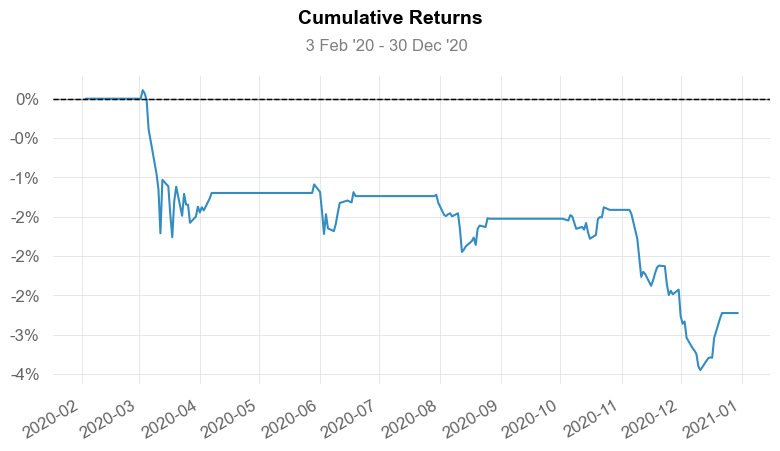

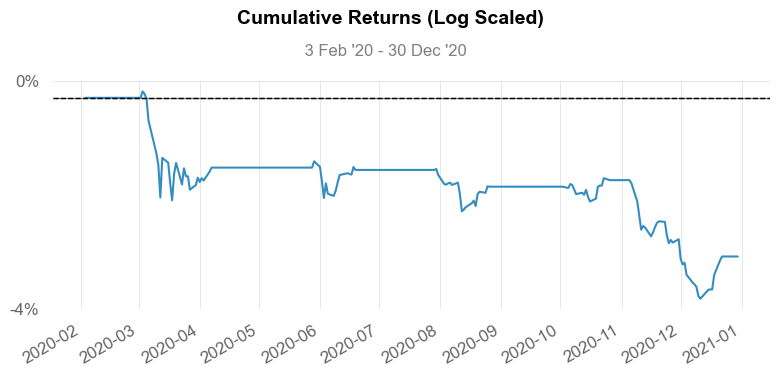

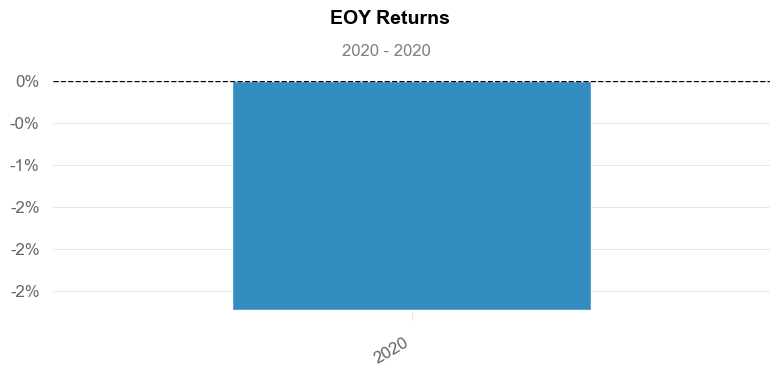

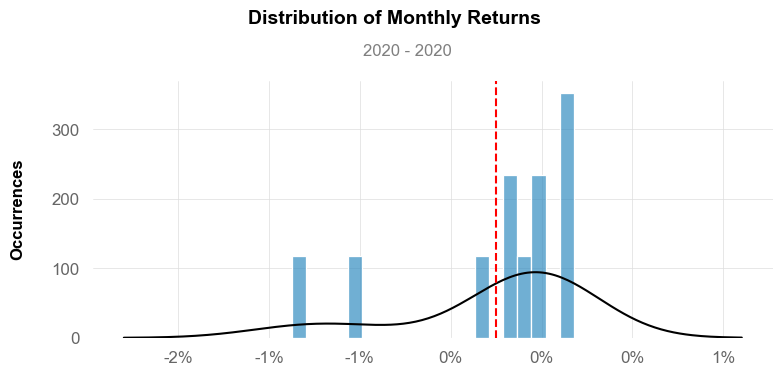

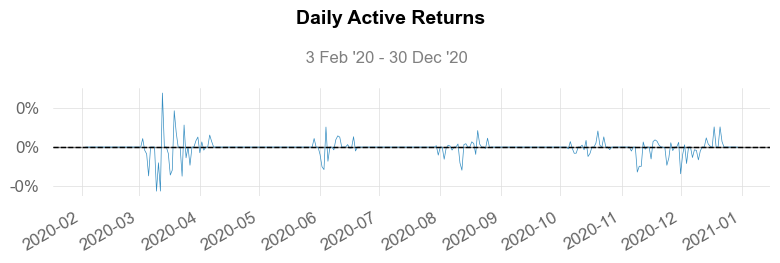

...

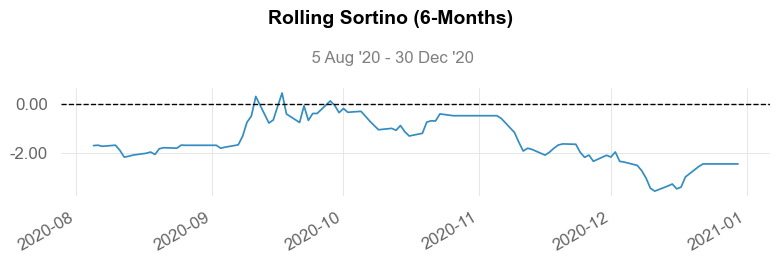

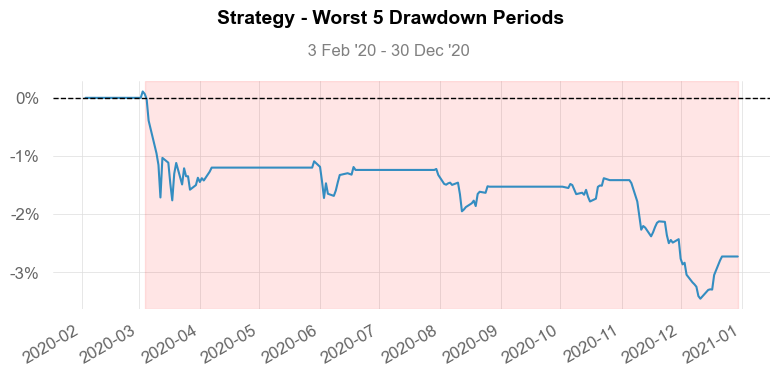

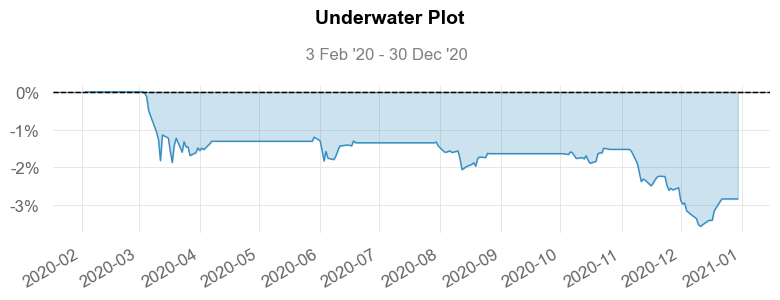

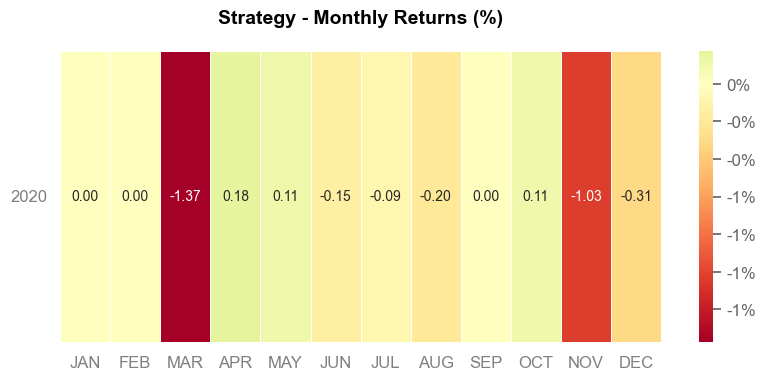

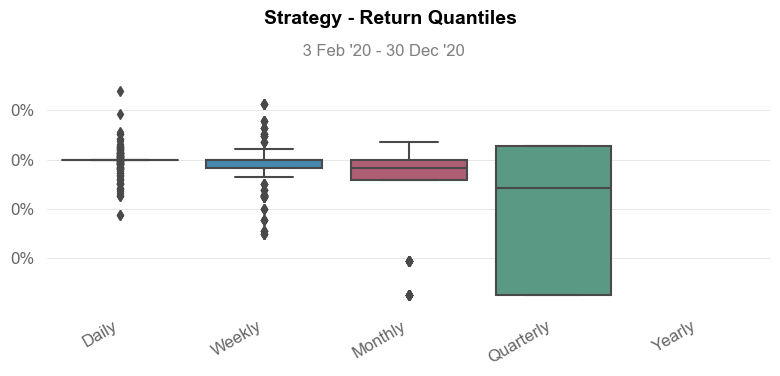

In [205]:
quantstats.reports.full(returns)

In [28]:
quantstats.stats.summary(returns)

AttributeError: module 'quantstats.stats' has no attribute 'summary'

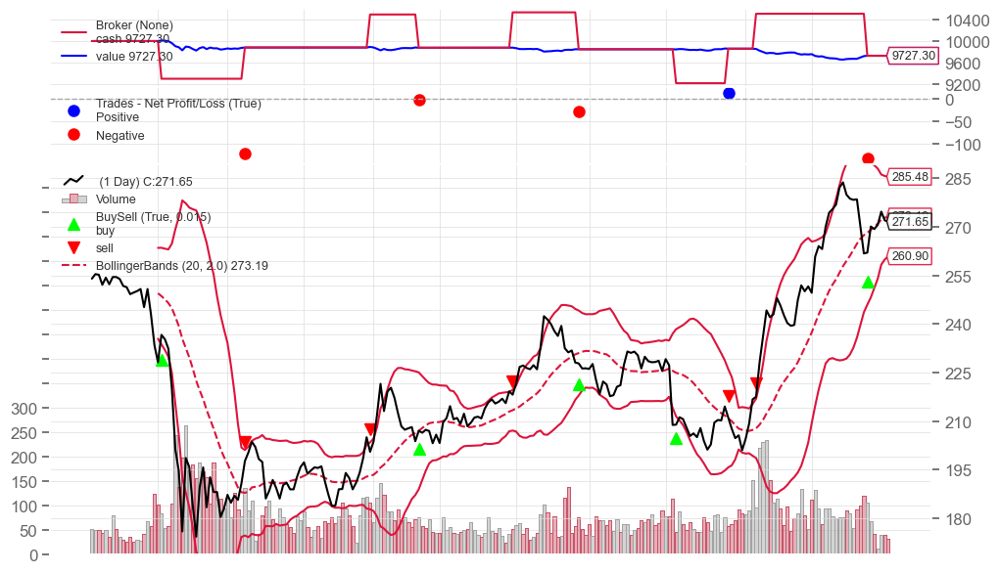

In [18]:
%matplotlib inline
figures = cerebro.plot(iplot=False)

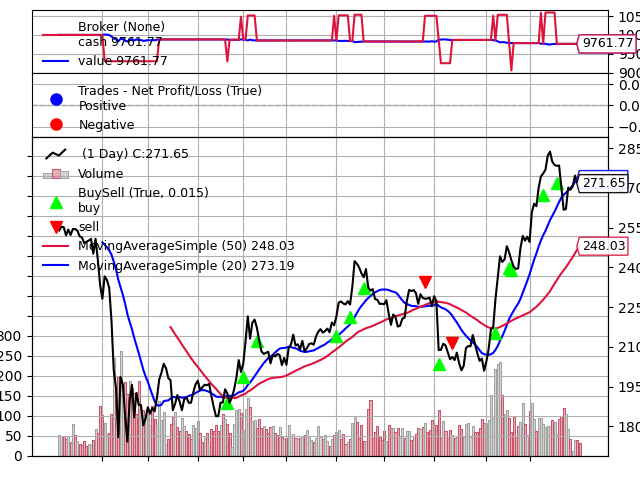

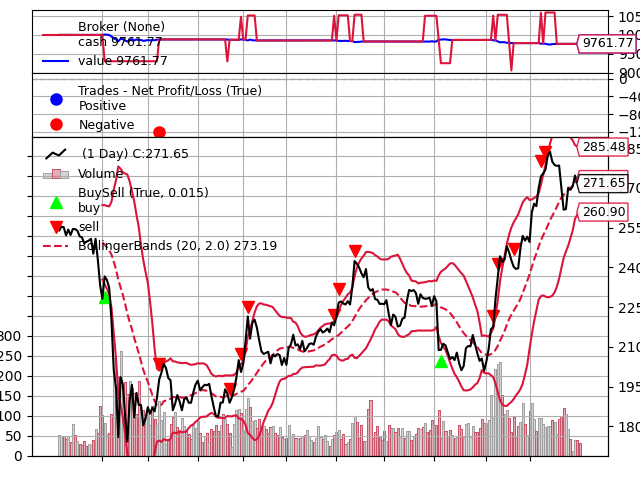

In [34]:
%matplotlib widget
figures = cerebro.plot(iplot=False)

## Optimization

In [122]:
cerebro = bt.Cerebro(optreturn=False)
cerebro.adddata(data_feed)

cerebro.addanalyzer(bt.analyzers.SharpeRatio, _name='sharpe_ratio', timeframe=bt.TimeFrame.Days, riskfreerate=0.01)
cerebro.optstrategy(TestStrategy, enable_log=False, pfast=range(5, 10), pslow=range(20, 100, 5))

cerebro.addsizer(bt.sizers.SizerFix, stake=3)
run = cerebro.run(maxcpus=1)

In [118]:
optimization_results = [
    dict(
        parameters=vars(strategy.params),
        sharpe_ratio=strategy.analyzers.sharpe_ratio.get_analysis()["sharperatio"]
    )
    for iteration in run
    for strategy in iteration
]
    
best_result = max(optimization_results, key=operator.itemgetter("sharpe_ratio"))
best_index = optimization_results.index(best_result)

In [125]:
# %matplotlib inline
# cerebro.plot(iplot=False)

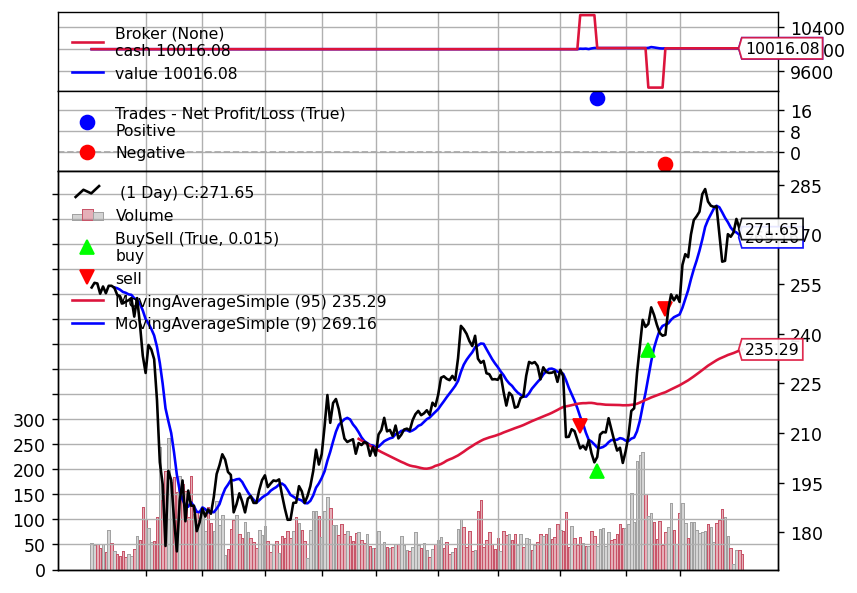

In [130]:
figures[4][0]

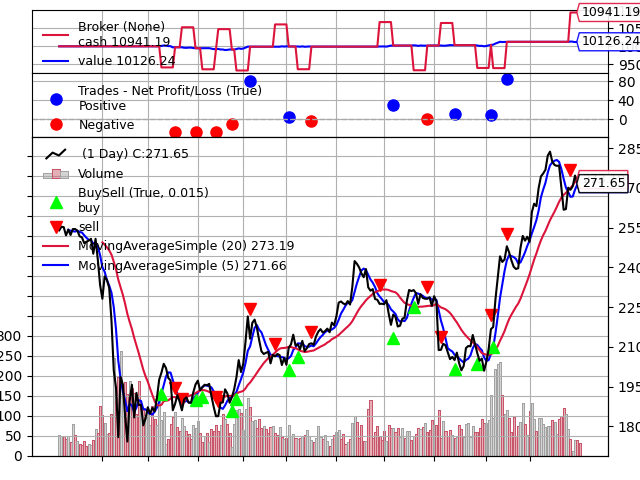

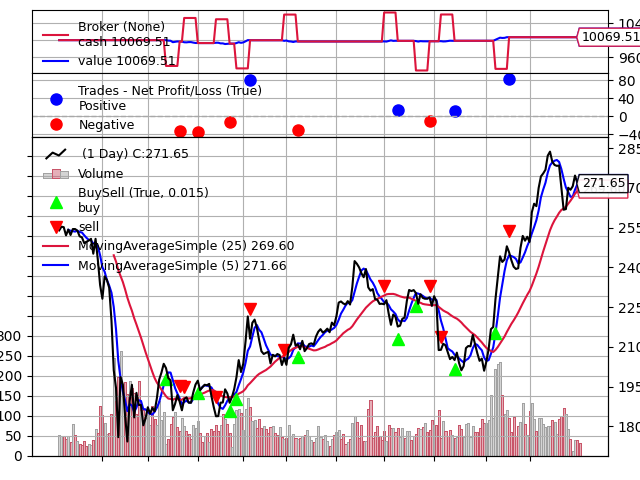

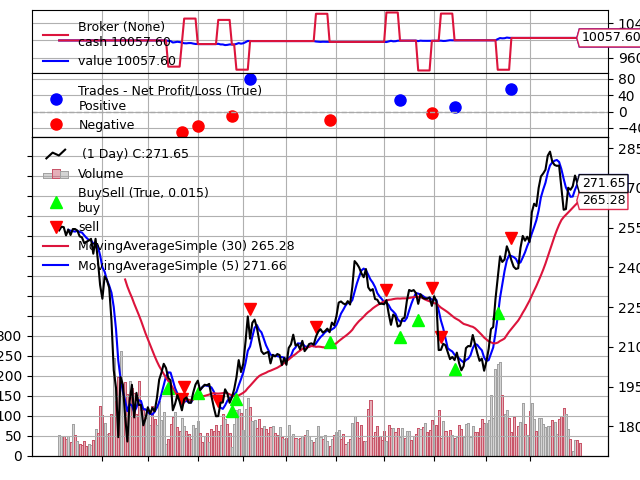

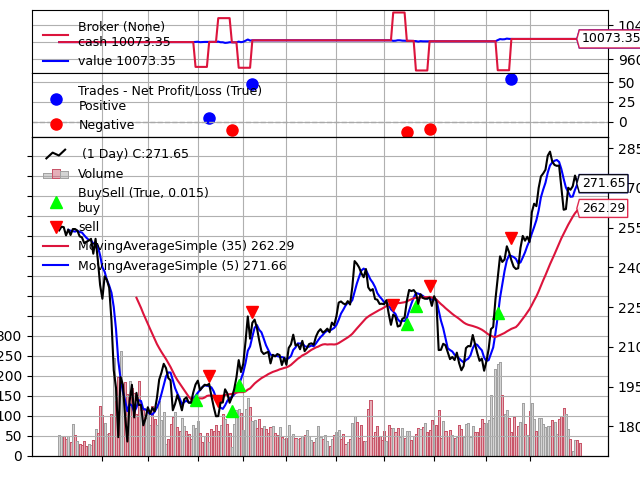

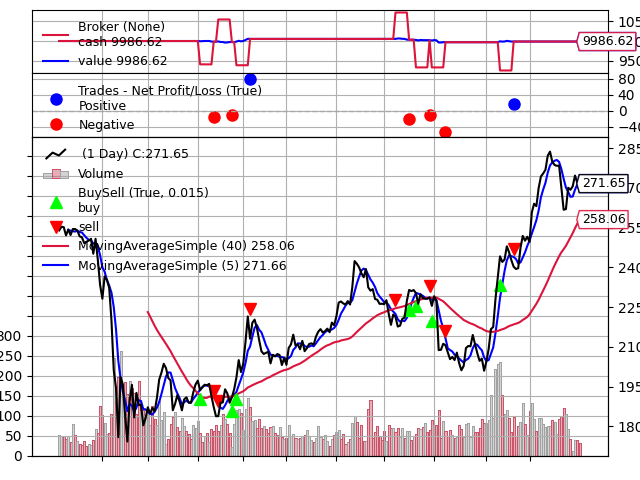

...

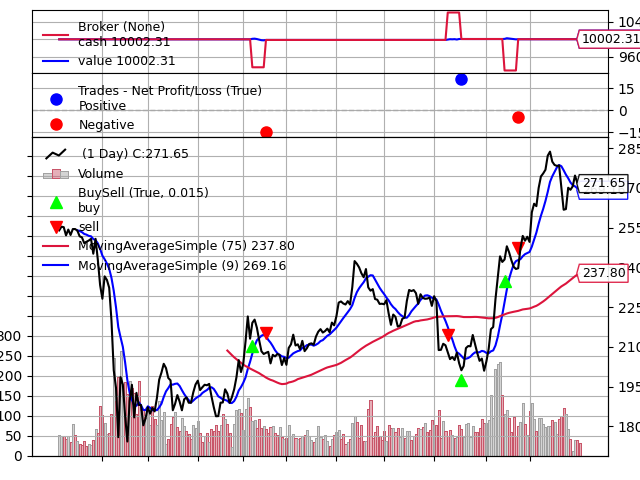

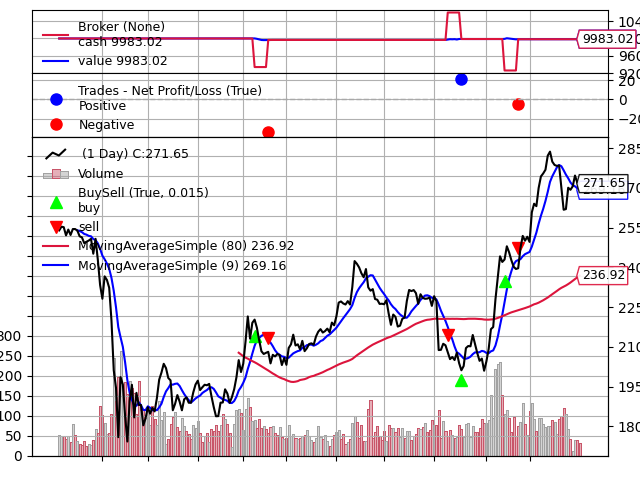

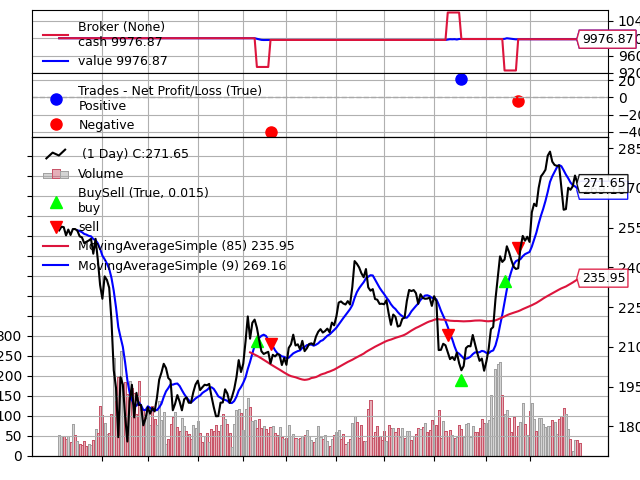

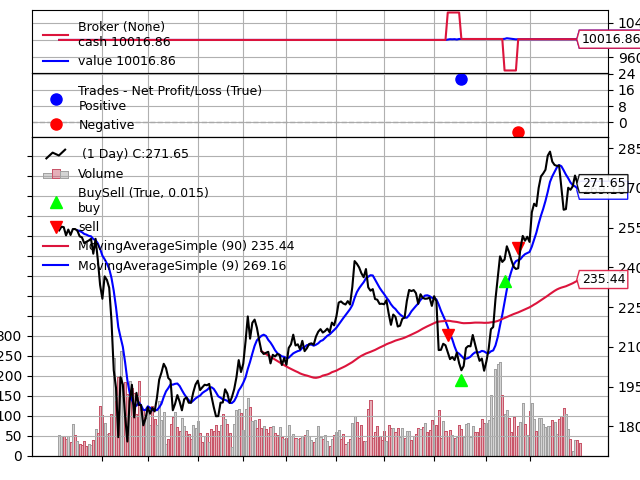

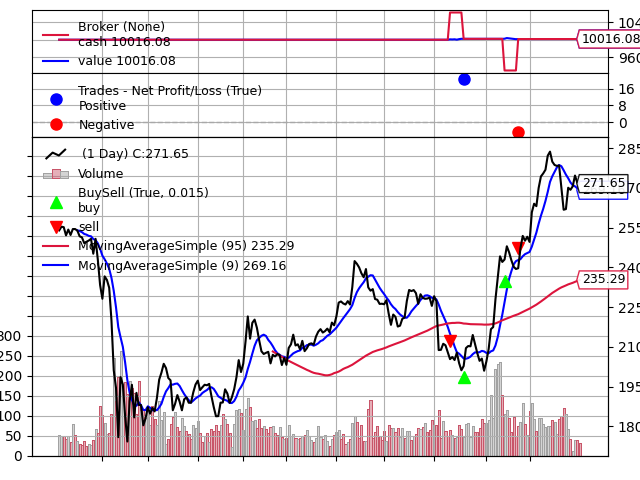

In [126]:
%matplotlib widget
figures = cerebro.plot(iplot=False);

In [127]:
figures

[[<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure size 800x600 with 4 Axes>],
 [<Figure si